In [1]:
#augment image data for dataset
#create models
#train models
#generate examples (val)
#walk latent space as in DCGAN

In [2]:
# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python Docker image: https://github.com/kaggle/docker-python
# For example, here's several helpful packages to load

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)
import random
from matplotlib import pyplot as plt
import matplotlib.animation as animation
from matplotlib.lines import Line2D
from IPython.display import HTML
import os

import skimage.io as io
from skimage.transform import rotate, AffineTransform, warp
from skimage.util import random_noise
from skimage.filters import gaussian

import torch
from torch import nn
from torchvision import transforms, datasets
from torch.utils.data import DataLoader
import torchvision.utils as vutils
from torch.optim import Adam


device = "cuda" if torch.cuda.is_available() else "cpu"
# You can write up to 20GB to the current directory (/kaggle/working/) that gets preserved as output when you create a version using "Save & Run All" 
# You can also write temporary files to /kaggle/temp/, but they won't be saved outside of the current session

# Explore Data

(256, 256, 3)


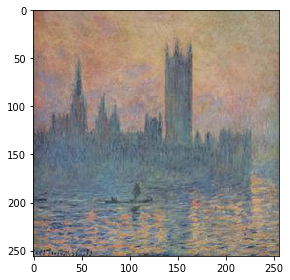

In [3]:
img = io.imread('../input/monet-jpg-improved/monet_jpg_improved/05144e306fa.jpg')
print(img.shape)
io.imshow(img)

In [4]:
data_path = '../input/monet-jpg-improved'
#check dimensions of all images
sizes = []
for directory in os.listdir(data_path):
    for file in os.listdir(data_path+'//'+directory):
        image = io.imread(data_path+'//'+directory+'//'+file)
        sizes.append(image.shape)

print('Num Images: ' + str(len(sizes)))
uniq_sizes = list(set(sizes))
print('Num Shapes: ' + str(len(uniq_sizes)))
print(uniq_sizes)

Num Images: 1788
Num Shapes: 1
[(256, 256, 3)]


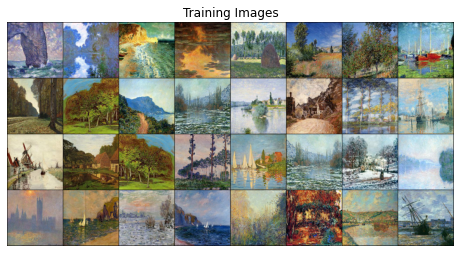

In [5]:
#create dataset
device = "cuda" if torch.cuda.is_available() else "cpu"

batch_size = 32

data = datasets.ImageFolder(root=data_path,
                           transform=transforms.Compose([
                               transforms.ToTensor(),
                               transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5))
                           ])
                           )

dataloader = DataLoader(data, batch_size=batch_size, shuffle=True)
real_batch = next(iter(dataloader))
plt.figure(figsize=(8,8))
plt.axis("off")
plt.title("Training Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:batch_size], padding=2, normalize=True).cpu(),(1,2,0)))

In [6]:
#info returned by dataloader in each batch: first element is batch of images, second is (useless) batch of labels
print(len(real_batch))
print(real_batch[0].size())
print(real_batch[1].size())

2
torch.Size([32, 3, 256, 256])
torch.Size([32])


# Generator and Discriminator Models

In [7]:
#adapted from: https://pytorch.org/tutorials/beginner/dcgan_faces_tutorial.html
#set bias=False in conv layers as BatchNorm2d implicitly adds a bias paramter
class Discriminator(nn.Module):
    def __init__(self, input_channels=3, n_filt=64):
        super(Discriminator, self).__init__()
        #defualt input size is 3 x 256 x 256
        self.network = []
        self.network.append(nn.Sequential(
            nn.Conv2d(input_channels, n_filt, kernel_size=4, stride=2, padding=1, bias=False),
            nn.LeakyReLU(0.2, inplace=True)
        ))
        
        #iterate, downsampling by 2 at each step but doubling the number of channels
        #by default depth=6 (5 hidden + output) results in a final size of n_filt*(2^5) x 4 x 4 prior to the final logit calculation
        for i in range(5):
            if i == 0:
                prev_filt = n_filt
            else:
                prev_filt = n_filt*(2**i)
                
            self.network.append(nn.Sequential(
            nn.Conv2d(prev_filt, n_filt*(2**(i+1)), kernel_size=4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(n_filt*(2**(i+1))),
            nn.LeakyReLU(0.2, inplace=True)
        ))
            
        #output layer with sigmoid
        self.network.append(nn.Sequential(
            nn.Conv2d(n_filt*(2**(5)), 1, kernel_size=4, stride=1, padding=0, bias=False),
            nn.Sigmoid()
        ))
        
        self.network = nn.ModuleList(self.network)
        
    def forward(self, x):
        o = x
        for index, layer in enumerate(self.network):
            o = layer(o)
            #print("D " + str(index))
            #print(o.size())
        
        return o
    
class Generator(nn.Module):
    def __init__(self, z_dim=100, n_filt=64, num_channels=3):
        super(Generator, self).__init__()
        
        self.network = []
        depth=6
        
        self.network.append(nn.Sequential(
            nn.ConvTranspose2d( z_dim, n_filt*(2**(depth-1)), kernel_size=4, stride=1, padding=0, bias=False),
            nn.BatchNorm2d(n_filt*(2**(depth-1))),
            nn.ReLU(inplace=True)
        ))
        
        for i in range(depth-1):
            self.network.append(nn.Sequential(
                nn.ConvTranspose2d( n_filt*(2**(depth-i-1)), n_filt*(2**(depth-i-2)), kernel_size=4, stride=2, padding=1, bias=False),
                nn.BatchNorm2d(n_filt*(2**(depth-i-2))),
                nn.ReLU(inplace=True)
            ))
            
        self.network.append(nn.Sequential(
            nn.ConvTranspose2d(n_filt, num_channels, kernel_size=4, stride=2, padding=1, bias=False),
            nn.Tanh()
        ))
        
        self.network = nn.ModuleList(self.network)
        
    def forward(self, x):
        o = x
        for index, layer in enumerate(self.network):
            o = layer(o)
            #print("G " + str(index))
            #print(o.size())
        
        return o
    
#copied directly from DCGAN tutorial above
# custom weights initialization called on netG and netD
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)
        
#https://discuss.pytorch.org/t/check-gradient-flow-in-network/15063  
def plot_grad_flow(named_parameters):
    '''Plots the gradients flowing through different layers in the net during training.
    Can be used for checking for possible gradient vanishing / exploding problems.
    
    Usage: Plug this function in Trainer class after loss.backwards() as 
    "plot_grad_flow(self.model.named_parameters())" to visualize the gradient flow'''
    ave_grads = []
    max_grads= []
    layers = []
    for n, p in named_parameters:
        if(p.requires_grad) and ("bias" not in n):
            layers.append(n)
            ave_grads.append(p.grad.abs().mean())
            max_grads.append(p.grad.abs().max())
    plt.figure()
    plt.bar(np.arange(len(max_grads)), max_grads, alpha=0.1, lw=1, color="c")
    plt.bar(np.arange(len(max_grads)), ave_grads, alpha=0.1, lw=1, color="b")
    plt.hlines(0, 0, len(ave_grads)+1, lw=2, color="k" )
    plt.xticks(range(0,len(ave_grads), 1), layers, rotation="vertical")
    plt.xlim(left=0, right=len(ave_grads))
    plt.ylim(bottom = -0.001, top=0.02) # zoom in on the lower gradient regions
    plt.xlabel("Layers")
    plt.ylabel("average gradient")
    plt.title("Gradient flow")
    plt.grid(True)
    plt.legend([Line2D([0], [0], color="c", lw=4),
                Line2D([0], [0], color="b", lw=4),
                Line2D([0], [0], color="k", lw=4)], ['max-gradient', 'mean-gradient', 'zero-gradient'])
    plt.show()

# Training

In [8]:
#hyper params from DCGAN Paper
z_dim = 100
lr = 0.00005
betas = (.5, .999)

netG = Generator(z_dim=z_dim, n_filt=64, num_channels=3)
netD = Discriminator(input_channels=3, n_filt=64)

netG.apply(weights_init)
netD.apply(weights_init)

criterion = nn.BCELoss()
optimizerG = Adam(netG.parameters(), lr=lr, betas=betas)
optimizerD = Adam(netD.parameters(), lr=lr, betas=betas)

netG.to(device)
netD.to(device)

#fixed noise to predict on, visualize model progress
fixed_noise = torch.randn(64, z_dim, 1, 1, device=device)

In [9]:
print(netG)
print(netD)

Generator(
  (network): ModuleList(
    (0): Sequential(
      (0): ConvTranspose2d(100, 2048, kernel_size=(4, 4), stride=(1, 1), bias=False)
      (1): BatchNorm2d(2048, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU(inplace=True)
    )
    (1): Sequential(
      (0): ConvTranspose2d(2048, 1024, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (1): BatchNorm2d(1024, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU(inplace=True)
    )
    (2): Sequential(
      (0): ConvTranspose2d(1024, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReLU(inplace=True)
    )
    (3): Sequential(
      (0): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (1): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): ReL

In [10]:
# Training Loop - adapted directly from DCGAN tutorial

# Lists to keep track of progress
img_list = []
G_losses = []
D_losses = []
iters = 0

num_epochs = 250

real_label = 0.9
fake_label = 0.1

#params for decaying noise to be added to discriminator input
mu = 0.0
std = 10.0

torch.autograd.set_detect_anomaly(True)

print("Starting Training Loop...")
print(device)
# For each epoch
for epoch in range(num_epochs):
    # For each batch in the dataloader
    for i, data in enumerate(dataloader, 0):

        ############################
        # (1) Update D network: maximize log(D(x)) + log(1 - D(G(z)))
        ###########################
        ## Train with all-real batch
        netD.zero_grad()
        # Format batch
        real_cpu = data[0].to(device)
        b_size = real_cpu.size(0)
        label = torch.full((b_size,), real_label, dtype=torch.float, device=device)
        # Forward pass real batch through D
        #add decaying noise to real input
        real_input = real_cpu + ( torch.randn(real_cpu.size(), device=device) + mu ) * (std/(epoch+1))
        output_real = netD(real_input).view(-1)
        
        # Calculate gradients for D in backward pass
        #errD_real.backward()
        D_x = output_real.mean().item()

        ## Train with all-fake batch
        # Generate batch of latent vectors
        noise = torch.randn(b_size, z_dim, 1, 1, device=device)
        # Generate fake image batch with G
        fake = netG(noise)
        f_label = torch.full((b_size,), fake_label, dtype=torch.float, device=device)#.fill_(fake_label)
        # Classify all fake batch with D
        #add decaying noise to fake input
        fake_input = fake + ( torch.randn(fake.size(), device=device) + mu ) * (std/(epoch+1))
        output_fake = netD(fake_input.detach()).view(-1)
        
        # Calculate the gradients for this batch
        #errD_fake.backward()
        
        # Calculate loss on all-real batch
        errD_real = criterion(output_real, label)
        # Calculate D's loss on the all-fake batch
        errD_fake = criterion(output_fake, f_label)
        
        # Add the gradients from the all-real and all-fake batches
        errD = errD_real + errD_fake
        #calculate average gradient as per Naruto-Sasuke
        gradD = errD * 0.5
        gradD.backward()
        
        D_G_z1 = output_fake.mean().item()
        # Update D
        optimizerD.step()

        ############################
        # (2) Update G network: maximize log(D(G(z)))
        ###########################
        netG.zero_grad()
        label.fill_(real_label)  # fake labels are real for generator cost
        # Since we just updated D, perform another forward pass of all-fake batch through D
        output = netD(fake_input).view(-1)
        # Calculate G's loss based on this output
        errG = criterion(output, label)
        # Calculate gradients for G
        errG.backward()
        D_G_z2 = output.mean().item()
        # Update G
        optimizerG.step()

        # Output training stats
        if i % 50 == 0:
            print('[%d/%d][%d/%d]\tLoss_D: %.4f\tLoss_G: %.4f\tD(x): %.4f\tD(G(z)): %.4f / %.4f'
                  % (epoch, num_epochs, i, len(dataloader),
                     errD.item(), errG.item(), D_x, D_G_z1, D_G_z2))

        # Save Losses for plotting later
        G_losses.append(errG.item())
        D_losses.append(errD.item())
        
        #plot gradient flow of generator
        #if iters == 10 or iters == 50 or iters % 500 == 0:
         #   plot_grad_flow(netG.named_parameters())

        # Check how the generator is doing by saving G's output on fixed_noise
        if (iters % 500 == 0) or ((epoch == num_epochs-1) and (i == len(dataloader)-1)):
            with torch.no_grad():
                fake = netG(fixed_noise).detach().cpu()
            img_list.append(vutils.make_grid(fake, padding=2, normalize=True))

        iters += 1

Starting Training Loop...
cuda
[0/250][0/56]	Loss_D: 2.6318	Loss_G: 1.7360	D(x): 0.3640	D(G(z)): 0.3449 / 0.4220
[0/250][50/56]	Loss_D: 3.5223	Loss_G: 2.6158	D(x): 0.3102	D(G(z)): 0.6468 / 0.0893
[1/250][0/56]	Loss_D: 4.2869	Loss_G: 5.7263	D(x): 0.5891	D(G(z)): 0.9024 / 0.0035
[1/250][50/56]	Loss_D: 4.3300	Loss_G: 2.6820	D(x): 0.2866	D(G(z)): 0.7021 / 0.0724
[2/250][0/56]	Loss_D: 4.0646	Loss_G: 4.6304	D(x): 0.5128	D(G(z)): 0.8333 / 0.0110
[2/250][50/56]	Loss_D: 4.8249	Loss_G: 5.7296	D(x): 0.3432	D(G(z)): 0.8866 / 0.0041
[3/250][0/56]	Loss_D: 4.5624	Loss_G: 10.7967	D(x): 0.8348	D(G(z)): 0.9387 / 0.0000
[3/250][50/56]	Loss_D: 1.6725	Loss_G: 3.7411	D(x): 0.7134	D(G(z)): 0.0462 / 0.0292
[4/250][0/56]	Loss_D: 1.5385	Loss_G: 4.1914	D(x): 0.8385	D(G(z)): 0.2998 / 0.0122
[4/250][50/56]	Loss_D: 4.6515	Loss_G: 4.1409	D(x): 0.2776	D(G(z)): 0.6403 / 0.0321
[5/250][0/56]	Loss_D: 6.0147	Loss_G: 6.7884	D(x): 0.3141	D(G(z)): 0.8532 / 0.0028
[5/250][50/56]	Loss_D: 3.7616	Loss_G: 3.1682	D(x): 0.2783	D(G

In [11]:
#save models
model_path = 'GANExp6.pt'
torch.save({
    'generator_state': netG.state_dict(),
    'discriminator_state': netD.state_dict(),
    'generator_optimizer_state': optimizerG.state_dict(),
    'discriminator_optimizer_state': optimizerD.state_dict()
}, model_path)

from IPython.display import FileLink
FileLink(model_path)

/kaggle/working/GANExp6.pt

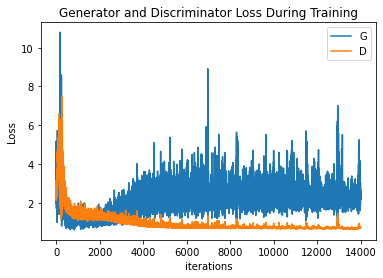

In [12]:
plt.figure()
plt.title("Generator and Discriminator Loss During Training")
plt.plot(G_losses,label="G")
plt.plot(D_losses,label="D")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

In [13]:
len(img_list)

29

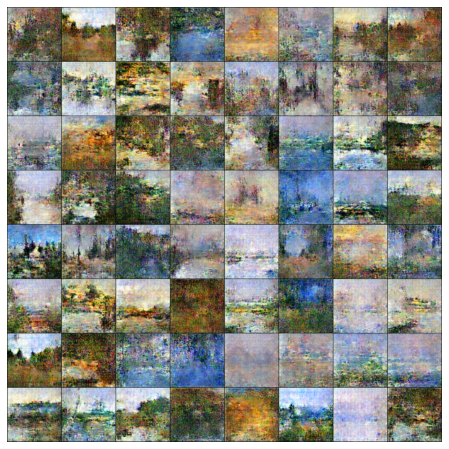

In [14]:
fig = plt.figure(figsize=(8,8))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in img_list]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

HTML(ani.to_jshtml())

# Exploring the Latent Space

<class 'torch.Tensor'>
torch.Size([3, 256, 256])


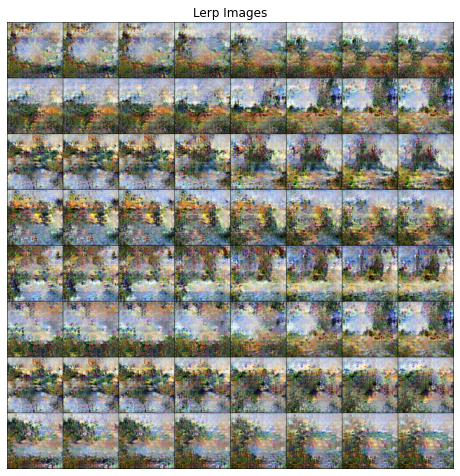

In [15]:
#linear interpolation between two images in latent space
def lerp(start, end, num_steps):
    weights = np.linspace(0,1, num=num_steps)
    points = [start]
    for w in weights:
        points.append(torch.lerp(start, end, w))
    points.append(end)
    
    return points


num_steps = 6
num_pairs = 8
points = []
lerp_images = []

for i in range(num_pairs):
    a = fixed_noise[random.randint(0,63)]
    b = fixed_noise[random.randint(0,63)]
    #get latent points in paths
    points.append(lerp(a,b,num_steps))

for item in points:
    for p in item:
        lerp_images.append( torch.squeeze( netG(torch.reshape(p, (1,p.size()[0],p.size()[1],p.size()[2])) ).detach() ) )

print(type(lerp_images[0]))  
print(lerp_images[0].size())
plt.figure(figsize=(8,num_steps*num_pairs))
plt.axis("off")
plt.title("Lerp Images")
plt.imshow(np.transpose(vutils.make_grid(lerp_images, padding=2, normalize=True).cpu(),(1,2,0)))

<class 'torch.Tensor'>
torch.Size([3, 256, 256])


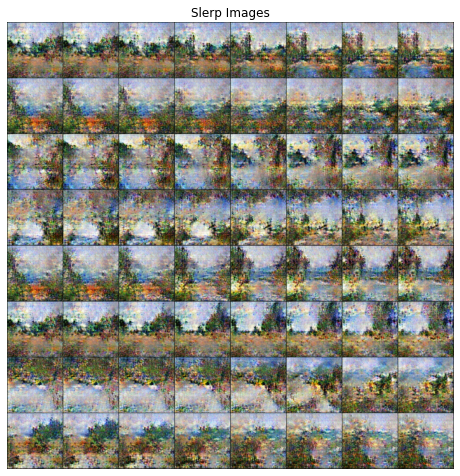

In [16]:
#spherical interpolation between two images in latent space
#https://github.com/soumith/dcgan.torch/issues/14
def slerp(val, low, high):
    omega = np.arccos(np.clip(np.dot(low/np.linalg.norm(low), high/np.linalg.norm(high)), -1, 1))
    so = np.sin(omega)
    if so == 0:
        return (1.0-val) * low + val * high # L'Hopital's rule/LERP
    return np.sin((1.0-val)*omega) / so * low + np.sin(val*omega) / so * high

def spherical_interp(start, stop, num_steps):
    weights = np.linspace(0,1, num=num_steps)
    points = [start]
    for w in weights:
        points.append( slerp(w, start, stop) )
    points.append(stop)
    
    return points
    
slerp_images = []
points = []

for i in range(num_pairs):
    a = fixed_noise[random.randint(0,63)]
    b = fixed_noise[random.randint(0,63)]
    points.append(spherical_interp(a.cpu().squeeze(),b.cpu().squeeze(),num_steps))

for item in points:
    for p in item:
        slerp_images.append( torch.squeeze( netG(torch.reshape(p, (1,p.size()[0],1,1)).to(device)).detach().cpu() ) )

print(type(slerp_images[0]))
print(slerp_images[0].size())
plt.figure(figsize=(8,num_steps*num_pairs))
plt.axis("off")
plt.title("Slerp Images")
plt.imshow(np.transpose(vutils.make_grid(slerp_images, padding=2, normalize=True).cpu(),(1,2,0)))

Notes on training attempts:

1. Vanilla attempt, D loss goes to 100 G loss goes to 0 around epoch 17, seems like mode collapse. Generator produces noise images which somehow minimize loss
Loss: BCELoss, Optim: Adam

2. As we have only about 1800 samples the collapse in the previous iteration could be due to a high learning rate, in this experiment lets reduce the learning rate from 0.0002 to 0.00001 the intuition for this change is that the generator may be overfitting for this particular discriminator too quickly (this is supported by the fact that this occurs in an early epoch)

Here the training looked more stable but the discriminator loss went to 0 while the GAN loss stbailized around 45-50. This is a documented issue. It seems that the Discriminator is learning the real distribution faster than the Generator can fool it, the learning rate reduction certainly helped but the generator still produced garbage images.

3. To address the Discriminator's strength relative to the Generator in the last experiment lets impair the Discriminator by implementing a form of label smoothing - adding noise to the labels so that the discriminators confidence decreases. Lets start with a simple technique: change real_label from 1->0.9 and fake_label from 0->0.1

This improves the GAN training and doesn't cause the discriminator loss to go to 0 as before, lets increase num_epochs from 50->200, still garbage images

4. Based on input from Naturo-Sasuke on PyTorch Forums, changed the Discriminator loss to (fake+real)/2
Still garbage, lets check gradient flows in Generator

As expected the gradient flows decreased greatly in the first few layers of the Generator as we iterated forward

5. To address this problem lets add decaying noise to the inputs of the discriminator
Success! The images look atleast passingly similar to the real monet styles - approx 130 epochs

6. Set num_epochs to 300, allow longer training with the intent of exploring the latent space next

Increase learning rate from 0.00001 -> 0.00005 results are even better